In [3]:
import itertools
import numpy as np
import os
import seaborn as sns
from tqdm import tqdm
from dataclasses import asdict, dataclass, field
import vsketch
import shapely.geometry as sg
from shapely.geometry import box, MultiLineString, Point, MultiPoint, Polygon, MultiPolygon, LineString
import shapely.affinity as sa
import shapely.ops as so
import matplotlib.pyplot as plt
import pandas as pd

import vpype_cli
from typing import List, Generic
from genpen import genpen as gp, utils as utils
from scipy import stats as ss
import geopandas
from shapely.errors import TopologicalError
import functools
%load_ext autoreload
%autoreload 2
import vpype
from skimage import io
from pathlib import Path
import fn
import bezier

from sklearn.preprocessing import minmax_scale
from skimage import feature
from genpen.utils import Paper
from genpen.genpen import *
from genpen import subdivide as sd
from functools import partial
from genpen.grower import Grower, GrowerParams

In [2]:
image_path= '/home/naka/art/wigglesphere.jpg'

paper_size:str = '7x5 inches'
border:float=15  # mm
image_rescale_factor:float=0.04
smooth_disk_size:int=1
hist_clip_limit=0.1
hist_nbins=32
intensity_min=0.
intensity_max=1.
hatch_spacing_min=0.35  # mm
hatch_spacing_max=1.1 # mm
pixel_width=1 # mm
pixel_height=1 # mm
angle_jitter='ss.norm(loc=10, scale=0).rvs'  # degrees
pixel_rotation='0'  # degrees
merge_tolerances=[0.3, 0.4,]  # mm
simplify_tolerances=[0.2,]  # mm
savedir='/home/naka/art/plotter_svgs'

In [3]:
# make page
paper = Paper(paper_size)
drawbox = paper.get_drawbox(border)


In [4]:
bps = gp.circle_pack_within_poly(drawbox, rads=[20, 10, 5, 2.5])

 75%|███████▌  | 3/4 [00:00<00:00,  7.94it/s]

In [5]:
bps2 = gp.circle_pack_within_poly(drawbox, rads=[20, 10, 5, 2.5])

In [6]:
bps = bps.difference(bps2.boundary.buffer(0.1))

In [7]:
bps = so.unary_union([bps2.difference(bps), bps.buffer(-0.1)])

In [8]:
n_layers = 1

In [9]:
layers = []
for ii in range(n_layers):
    fills = []
    for p in bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.1, 1.5)).rvs
        dist_from_center = p.centroid.distance(bps.centroid)
        a = np.interp(dist_from_center, [0, 150], [0, 1020])
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.2, 0.4),
            degrees=a,
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=15,
            n_eval_points=100,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    layers.append(layer)

 75%|███████▌  | 3/4 [00:19<00:06,  6.55s/it]


In [10]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

# sk.stroke(len(layers)+2)
# sk.geometry(blss)
    
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-02T18:00:09.571777 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="227.2615,69.0589 227.0776,69.0012 226.7961,68.8984 226.516,68.7805 226.2374,68.6471 225.9603,68.4978 225.6847,68.3325 225.4106,68.1517 225.1379,67.9561 224.8666,67.7467 224.5964,67.5249 224.3272,67.2926 224.0589,67.052 223.791,66.8055 223.5235,66.5559 223.256,66.3064 222.9881,66.0603 222.7196,65.8212 222.4501,65.5927 222.1792,65.3787 221.9065,65.1832 221.6317,65.01 221.3543,64.863 221.0742,64.746 220.7908,64.6627 220.5038,64.6164 220.213,64.6104 219.9181,64.6474 219.6189,64.7299 219.3151,64.8599 219.0067,65.0388 218.6935,65.2677 218.3755,65.5467 218.0527,65.8756 217.7252,66.2534 217.3933,66.6783 217.0576,67.147"/>
 <polyline points="216.5984,66.5149 216.871,66.0457 217.2154,65.4909 217.555,64.9857 217.8895,64.5337 218.2187,64.1373 218.5424,63.7986 218.8605,63.5183 219.1731,63.2968 219.48,63.1334 219.7816,63.0268 220.0778,62.9752 220.3691,62.976 220.6557,63.0263 220.9379,63.1224 221.216,63.2607 221.4905,63.4368 221.7619,63.6465 222.0304,63.8852 222.2967,64.1483 222.561,64.4311 222.8239,64.7292 223.0858,65.0381 223.347,65.3537 223.6079,65.672 223.869,65.9894 224.1304,66.3027 224.3925,66.6089 224.6555,66.9057 224.9196,67.1911 225.185,67.4633 225.4517,67.7214 225.7199,67.9645 225.9895,68.1923 226.2605,68.4049 226.533,68.6026 226.8068,68.7861 227.0819,68.9563 227.2615,69.0589"/>
 
 <polyline points="232.1264,68.7045 232.0608,68.6863 231.7801,68.5742 231.5022,68.4337 231.2265,68.2702 230.9524,68.089 230.6796,67.8949 230.4076,67.6922 230.1361,67.4847 229.8647,67.2754 229.5932,67.067 229.3215,66.8613 229.0494,66.6594 228.7769,66.4619 228.504,66.269 228.2307,66.0801 227.9571,65.8944 227.6832,65.7108 227.4094,65.5279 227.1356,65.3441 226.862,65.1577 226.5888,64.9673 226.3162,64.7712 226.0442,64.5681 225.773,64.357 225.5027,64.137 225.2332,63.9077 224.9647,63.6691 224.697,63.4214 224.43,63.1656 224.1638,62.9029 223.898,62.6351 223.6325,62.3643 223.367,62.0932 223.1013,61.8249 222.835,61.5627 222.5677,61.3105 222.2991,61.0723 222.0467,60.867"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="232.0844,70.7829 232.0512,70.9093 231.97,71.2167 231.8883,71.521 231.8058,71.8205 231.7224,72.1138 231.6378,72.3996 231.5518,72.6765 231.4642,72.9434 231.3748,73.1992 231.2836,73.443 231.1903,73.6736 231.0947,73.8902 230.9968,74.0919 230.8964,74.2776 230.7934,74.4466 230.6876,74.5979 230.5788,74.7306 230.467,74.8439 230.352,74.9369 230.2336,75.0088 230.1118,75.0588 229.9864,75.0861 229.8573,75.09 229.7245,75.0701 229.5878,75.0256 229.4472,74.9563 229.3026,74.862 229.1541,74.7425 229.1526,74.7411"/>
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="243.092,88.2101 243.2057,88.0854 243.3864,87.8777 243.5637,87.6632 243.7372,87.4416 243.907,87.2129 244.0731,86.9771 244.2358,86.7349 244.3955,86.4869 244.5526,86.2341 244.7079,85.9777 244.8619,85.7188 245.0153,85.459 245.169,85.1995 245.3236,84.9418 245.4797,84.687 245.6379,84.4362 245.7986,84.1901 245.9621,83.9494 246.1283,83.7139 246.2972,83.4835 246.4683,83.2572 246.6408,83.0339 246.814,82.8116 246.9866,82.5882 247.1571,82.3609 247.3239,82.1265 247.4852,81.8817 247.6392,81.6227 247.7837,81.3459 247.9052,81.0735"/>
 
 
 <polyline points="247.9052,81.0735 247.7198,81.2239 247.4919,81.3417 247.2431,81.4196 246.9775,81.4655 246.6991,81.4869 246.4118,81.4913 246.1194,81.486 245.8253,81.4774 245.5326,81.4716 245.2441,81.4737 244.9622,81.4883 244.6887,81.519 244.4251,81.5687 244.1725,81.6393 243.9315,81.7322 243.7025,81.848 243.4855,81.9865 243.2801,82.1472 243.0857,82.329 242.9016,82.5303 242.7267,82.7493 242.5601,82.9841 242.4006,83.2324 242.247,83.492 242.0982,83.7607 241.953,84.0364 241.8105,84.3171 241.6695,84.6009 241.5294,84.8861 241.3892,85.1714 241.2485,85.4556 241.1067,85.7377 240.9635,86.0172 240.8186,86.2934 240.6719,86.5661 240

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

In [ ]:
def vsketch_to_shapely(sketch):
    return [[LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer] for layer in sketch.document.layers.values()]

layer = sk.document.layers[1]

mls = gp.make_like(MultiLineString([LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer]), drawbox)

ds = [150 - ls.distance(drawbox.centroid) for ls in mls]

ds = np.array(ds) ** 0.5
ds = ds/ ds.sum()

frac_keep = 0.95
n_keep = int(frac_keep * len(mls))
pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False, p=ds)))
rlayers = [pmls]

sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(rlayers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
    sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

In [ ]:
plot_id = fn.new_plot_id()

In [ ]:
savedir='/home/naka/art/plotter_svgs'

In [ ]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

In [ ]:
sk.vpype('stat')

In [ ]:
pmls.length

# try 2

In [4]:
image_path= '/home/naka/art/wigglesphere.jpg'

paper_size:str = '11x14 inches'
border:float=15  # mm
image_rescale_factor:float=0.04
smooth_disk_size:int=1
hist_clip_limit=0.1
hist_nbins=32
intensity_min=0.
intensity_max=1.
hatch_spacing_min=0.35  # mm
hatch_spacing_max=1.1 # mm
pixel_width=1 # mm
pixel_height=1 # mm
angle_jitter='ss.norm(loc=10, scale=0).rvs'  # degrees
pixel_rotation='0'  # degrees
merge_tolerances=[0.3, 0.4,]  # mm
simplify_tolerances=[0.2,]  # mm
savedir='/home/naka/art/plotter_svgs'

In [6]:
# make page
paper = Paper(paper_size)
drawbox = paper.get_drawbox(border)


In [7]:
bps = gp.circle_pack_within_poly(drawbox, rads=[10, 8, 6])

 67%|██████▋   | 2/3 [00:21<00:10, 10.38s/it]

In [8]:
bps2 = gp.circle_pack_within_poly(drawbox, rads=[11, 9, 7])


 67%|██████▋   | 2/3 [00:16<00:07,  7.46s/it]

In [9]:
bps3 = gp.circle_pack_within_poly(drawbox, rads=[9, 7, 5])



  0%|          | 0/3 [00:00<?, ?it/s]

 33%|███▎      | 1/3 [00:50<01:41, 50.58s/it]

 67%|██████▋   | 2/3 [01:06<00:29, 29.97s/it]

In [74]:
bps = bps.difference(bps2.boundary.buffer(0.0))

In [10]:
bps = so.unary_union([bps2.difference(bps), bps.buffer(-0.01)])

In [11]:
bps = so.unary_union([bps3.difference(bps), bps.buffer(-0.01)])

In [12]:
n_layers = 1

In [24]:
layers = []
for ii in range(n_layers):
    fills = []
    for p in bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.01, 0.25)).rvs
        dist_from_center = p.centroid.distance(bps.centroid)
        a = np.interp(dist_from_center, [0, 170], [0, 1500])
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.2, 0.3),
            degrees=a,
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=8,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    layers.append(layer)

In [25]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

# sk.stroke(len(layers)+2)
# sk.geometry(blss)
    
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-07T15:33:35.316317 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="799.2779,72.2699 799.2844,72.2813 799.8219,73.218 800.36,74.1542 800.899,75.0899 801.4392,76.025 801.9806,76.9593 802.5233,77.8929 803.0674,78.8257 803.6126,79.7578 804.159,80.6893 804.7063,81.6203 805.2542,82.5508 805.8025,83.4812 806.3509,84.4115 806.8991,85.3419 807.4467,86.2727 807.9935,87.2039 808.539,88.1359 809.0829,89.0688 809.625,90.0027 810.1649,90.9379 810.7025,91.8745 811.2376,92.8124 811.7701,93.752 812.2998,94.693 812.8269,95.6356 813.3515,96.5797 813.8736,97.5251 813.8847,97.5453"/>
 <polyline points="814.8628,97.6904 814.5607,97.1284 814.0464,96.1785 813.529,95.2303 813.0082,94.284 812.4839,93.3398 811.9561,92.3976 811.4249,91.4574 810.8903,90.5191 810.3525,89.5827 809.812,88.6478 809.269,87.7144 808.7238,86.7823 808.1769,85.8511 807.6287,84.9207 807.0796,83.9908 806.5301,83.0611 805.9805,82.1315 805.4312,81.2017 804.8824,80.2716 804.3346,79.341 803.7879,78.4097 803.2424,77.4778 802.6981,76.5451 802.1552,75.6116 801.6134,74.6775 801.0726,73.7428 800.5324,72.8078 799.9925,71.8725 799.666,71.3072"/>
 <polyline points="800.0727,70.4471 800.1305,70.5459 800.6746,71.4788 801.2183,72.4117 801.7623,73.3446 802.3069,74.2771 802.8524,75.2091 803.3989,76.1405 803.9466,77.0712 804.4955,78.0012 805.0455,78.9306 805.5964,79.8594 806.1481,80.7878 806.7003,81.7159 807.2527,82.6439 807.8049,83.572 808.3567,84.5004 808.9075,85.4293 809.4571,86.3589 810.005,87.2895 810.5509,88.2212 811.0943,89.1544 811.6351,90.0891 812.1728,91.0256 812.7072,91.9639 813.2383,92.9043 813.7658,93.8467 814.2896,94.7911 814.8099,95.7376 815.3268,96.6862 815.8404,97.6366 815.9091,97.7646"/>
 <polyline points="816.8482,97.8108 816.5379,97.2338 816.023,96.2842 815.5046,95.3366 814.9828,94.3909 814.4575,93.4473 813.9287,92.5056 813.3967,91.5659 812.8615,90.628 812.3234,89.6917 811.7827,88.757 811.2396,87.8236 810.6946,86.8914 810.1478,85.9601 809.5998,85.0296 809.0508,84.0996 808.5013,83.17 807.9515,82.2405 807.4018,81.3109 806.8525,80.3812 806.3038,79.451 805.7559,78.5204 805.209,77.5893 804.6631,76.6575 804.1183,75.7251 803.5744,74.7922 803.0313,73.8588 802.4889,72.9251 801.9466,71.9913 801.4041,71.0576 800.8608,70.1243 800.5401,69.5752"/>
 <polyline points="801.0333,68.7523 801.0445,68.7713 801.5891,69.7038 802.1316,70.6375 802.6729,71.572 803.2135,72.5068 803.7539,73.4416 804.2947,74.3763 804.8361,75.3107 805.3783,76.2446 805.9215,77.1779 806.4657,78.1106 807.0109,79.0428 807.5569,79.9744 808.1037,80.9057 808.6509,81.8367 809.1983,82.7676 809.7456,83.6985 810.2926,84.6296 810.8388,85.5612 811.3839,86.4934 811.9276,87.4264 812.4696,88.3604 813.0095,89.2956 813.547,90.2322 814.082,91.1703 814.6141,92.11 815.1432,93.0514 815.6691,93.9947 816.1918,94.9398 816.7111,95.8869 817.2272,96.8358 817.7348,97.7768"/>
 <polyline points="818.5674,97.7359 818.393,97.4097 817.8809,96.4585 817.3659,95.5089 816.8481,94.5609 816.3276,93.6145 815.8045,92.6696 815.2789,91.7261 814.7509,90.784 814.2208,89.8432 813.6886,88.9035 813.1546,87.9649 812.619,87.0272 812.0821,86.0903 811.544,85.154 811.005,84.2183 810.4654,83.2829 809.9253,82.3478 809.3849,81.4129 808.8445,80.478 808.3041,79.543 807.764,78.608 807.2241,77.6727 806.6846,76.7373 806.1455,75.8016 805.6066,74.8659 805.0678,73.93 804.5289,72.9942 803.9896,72.0587 803.4496,71.1235 802.9083,70.1891 802.3652,69.2557 801.8196,68.3238 801.591,67.9363"/>
 <polyline points="802.0942,67.2579 802.4895,67.9371 803.0304,68.8717 803.5699,69.8072 804.1086,70.743 804.6473,71.6789 805.1864,72.6146 805.7262,73.5499 806.267,74.4846 806.8089,75.4186 807.352,76.352 807.8962,77.2847 808.4415,78.2168 808.9877,79.1484 809.5346,80.0795 810.0819,81.0105 810.6294,81.9413 811.1768,82.8722 811.7237,83.8034 812.2697,84.735 812.8147,85.6673 813.3582,86.6004 813.9,87.5346 814.4397,88.4698 814.9773,89.4064 815.5123,90.3444 816.0447,91.284 816.5744,92.2251 817.1013,93.1678 817.6253,94.1122 818.1465,95.0582 818.66

In [26]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-07T15:34:05.991055 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="858.4249,110.4576 845.5733,110.4917 815.3879,109.6133 806.1688,109.5876 805.8329,109.7389 794.6628,106.941 779.4768,102.6885 775.4105,101.7414 774.7361,101.9104 780.7481,103.4924 794.4315,107.8244 804.8913,110.6266 804.8975,110.7322 805.2724,110.4 813.24,110.411 845.5825,111.4524 852.0497,111.5311 859.2667,111.3738 858.8806,110.8267 858.9825,111.004 859.2737,110.9708 851.035,97.9087 847.2126,91.3585 844.6847,86.48 844.7487,85.1774 847.0454,89.7035 850.04,94.9803 860.0322,111.3295 860.4463,111.5672 862.1034,114.3166 861.8605,114.4527 858.5459,114.6476 849.9254,114.8081 819.7416,114.0943 801.9245,114.1853 788.0963,109.383 781.5742,107.4196 779.3156,113.7902 777.5148,120.001 772.1062,143.107 769.3332,153.5219 767.3358,159.6778 765.832,163.7337 761.997,172.5698 764.4105,173.8721 774.5505,171.5014 792.643,167.6463 792.3928,167.4945 792.7773,157.2981 792.8299,151.6251 792.5744,145.9216 792.4367,146.1602 793.1981,143.1206 794.5268,142.8129 794.5226,142.5273 813.5509,143.0412 837.2712,144.065 845.8944,144.1983 854.5143,143.978 860.9766,143.5318 869.7018,142.5645 869.7477,141.958 860.9699,142.8277 854.5073,143.2405 848.0424,143.4095 841.5755,143.3707 813.543,142.2174 794.391,141.6401 794.2714,140.7311 813.5343,141.3035 837.2549,142.3608 845.8786,142.5314 852.3443,142.4493 858.8078,142.1382 869.3257,141.0807 869.3616,141.3541 869.7364,140.957 876.8902,152.9013 889.1403,172.0432 889.5088,172.3082 878.6164,172.9769 884.4232,205.767 889.2982,232.1715 889.3827,238.3049 888.88,238.4053 888.3204,238.3949 888.4712,238.3497 888.3237,233.4064 888.5121,233.0387 877.5634,172.4788 878.1025,172.6502"/>
 
 <polyline points="893.5985,238.3119 893.4032,231.6358 893.606,226.6718 893.0726,227.4883 887.3864,196.4682 883.8771,176.2166 884.0638,176.2609 883.7575,175.9867 896.5606,175.2911 895.9422,174.9688 891.1739,167.0541 877.3395,145.1753 870.1823,132.9283 870.0251,133.2155 869.216,131.7815 865.1811,132.3541 858.7203,132.9541 847.9462,133.3077 813.4499,132.4402 794.4218,132.5266 794.2577,132.8603 793.9792,132.7733 793.8854,132.404 794.3548,132.2056 793.9446,132.0693 786.5493,157.7517 786.8526,157.5332 785.9086,167.0465 771.7442,169.732 771.9102,169.7722 776.3234,157.7099 780.7673,143.2857 788.4243,115.6944 787.5254,114.1027"/>
 
 
 
 
 <polyline points="884.3126,168.8988 870.5775,169.9019 870.7494,170.0618 871.306,173.0954 882.6897,237.8892 882.8045,237.8982 882.305,238.2685 882.4729,239.4407 890.5458,239.2546 897.409,238.8402 897.1109,238.6813 897.0164,231.6765 897.7898,217.6842 895.2024,203.8143 891.7615,183.9496 892.0908,184.2668 898.7922,183.9591 898.644,184.1789 908.0341,184.4498 907.8621,184.731 912.4161,185.3969 916.7055,185.8265 942.5507,187.3255 953.2945,188.1975 959.7104,189.0215 963.9629,189.8147 968.1854,190.906 970.989,191.8713"/>
 
 <polyline points="945.4347,143.1809 951.2901,151.9274 955.5906,159.1508 955.898,159.4232 961.3374,170.7002 965.9471,179.6362 969.6474,186.1979 973.7183,192.6634 977.4546,199.6882 981.4496,207.9954 984.3517,215.1671 984.788,215.5377 974.8016,212.2573 974.7036,212.1062 972.6121,211.3964 970.504,210.8202 966.2555,209.9872 959.8299,209.2592 940.4739,207.8588 927.6178,206.4515 910.5362,203.9838 904.1603,202.7643 900.0316,201.7703 899.8896,202.2125 899.1458,202.591 899.9057,202.6186 899.9708,202.4377 914.7611,205.0509 933.9795,207.8118 944.6941,208.9723 959.7393,210.1549 966.1619,210.9123 970.4111,211.7386 974.7014,212.9327 986.4807,216.8533 985.6327,216.1171 982.3241,207.4905 978.9634,200.1199 982.2706,207.5214 985.3591,215.9142"/>
 <polyline points="983.1583,214.4093 980.6374,208.4644 978.6583,204.3001 972.7777,193.2272 972.4512,193.4229 978.333,204.4879 980.3064,208.6554 982.6238,214.089 982.3553,213.928 980.0628,208.7961 976.9465,202.635 971.8075,193.5135 971.8868,193.7696 968.029,192.4517 961.6806,190.9607 957.4172,190.2743 950.9937,189.5258 940.2471,188.6816 916.5456,187.4072 

In [34]:
def vsketch_to_shapely(sketch):
    return [[LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer] for layer in sketch.document.layers.values()]

In [35]:
layer = sk.document.layers[1]

In [36]:
mls = gp.make_like(MultiLineString([LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer]), drawbox)

In [37]:
ds = [200 - ls.distance(drawbox.centroid) for ls in mls]

In [38]:
ds = np.array(ds) ** 0.5
ds = ds / ds.sum()

In [39]:
ds

array([0.00015246, 0.00015609, 0.00015427, ..., 0.00019397, 0.000218  ,
       0.00024141])

In [45]:
frac_keep = 0.5
n_keep = int(frac_keep * len(mls))
pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
                                             p=ds
                                            )))
rlayers = [pmls]

<ipython-input-45-919d49dc7188>:3: FutureWarning: The input object of type 'LineString' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'LineString', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
<ipython-input-45-919d49dc7188>:3: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,


In [46]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(rlayers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
    sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-07T15:41:20.658611 
 
 
 
 
 
 <polyline points="495.2856,92.7751 498.8762,89.9417 498.8252,90.1004 500.7122,95.0559 504.8569,105.0925 508.4324,112.9766 511.297,118.7873 517.5312,130.1262 527.2882,146.0873 527.2971,146.2033 515.7645,153.0405 512.8612,169.6178 512.0921,176.129 511.7948,180.46 511.7334,186.9391 511.9716,191.2459 512.4455,195.542 513.5899,201.8124 513.4974,202.0834 519.7783,204.635 528.6421,208.6014 536.7024,206.5569 536.5115,206.3329 534.0,196.5672 531.7437,186.0059 529.6837,173.2314 528.1578,160.1504 521.6388,163.9021 521.3965,163.2249 528.954,158.8221 528.8112,159.281 529.7286,168.8591 531.5257,181.6746 533.6065,192.2633 537.3278,207.2258 528.8643,209.2108 528.6885,209.5449 519.4828,205.3066 512.9691,202.6663 512.0705,197.7177 511.3141,191.2757 511.0518,186.97 510.9988,180.4961 511.1752,176.1706 511.7185,169.6696 512.842,160.9836 514.3644,151.5161 514.2068,151.1732 523.6756,145.6042 524.0053,145.5699 515.302,131.373 509.0979,120.0173 503.6017,108.2656 500.2698,100.2453 497.4262,92.8608 496.751,94.1081 496.914,93.9438 502.8001,108.714 507.2747,118.5661 510.23,124.326 513.4023,129.9646 516.763,135.4978 523.0949,145.3418 522.561,145.3251 513.6594,150.5693 513.4637,150.5223 510.9709,165.3859 510.2006,171.8972 509.7273,178.395 509.6078,184.8767 509.7464,189.188 510.3133,195.6386 511.1095,200.7187 510.2126,195.6432 509.5218,189.1982 509.3154,184.89 509.364,178.4114 509.8011,171.9153 510.5552,165.4048 513.0713,149.9204 521.3984,145.0338 520.8677,144.784 515.4278,136.2447 511.0337,128.8185 507.9718,123.1182 505.1268,117.2965 502.4781,111.3651 496.2358,95.7608 495.7628,97.0829 500.1873,107.7044 504.6962,117.5373 510.6683,129.0229 519.6525,144.366 519.26,144.3059 511.7832,148.6727 511.9411,148.9689 510.2558,158.942 509.0353,167.6324 508.3944,174.1378 508.1526,178.4663 508.1295,184.9437 508.5693,191.4001 509.5223,197.8332 511.0663,204.298 510.2645,205.1267 509.0958,200.0114 508.3764,195.7264 507.8747,191.4316 507.4866,184.9729 507.4466,180.6571 507.6713,174.1706 508.8617,161.164 510.5606,147.5645 517.2601,143.6305 514.7121,142.3928 514.9218,142.5338 508.7441,146.1104 508.911,146.3754 507.3291,159.0747 506.446,167.7498 506.0228,174.2453 505.9165,180.7265 506.2029,187.1898 506.9261,193.6334 507.6624,197.9176 509.4393,205.7068 507.9989,200.0611 507.1343,195.7827 505.9653,187.2006 505.5395,178.5848 505.582,174.2653 505.9008,167.7745 507.9921,145.6939 514.0407,142.1171"/>
 
 <polyline points="505.087,143.6599 510.9306,140.2806 511.7509,140.7723 505.9312,144.1659 505.6027,144.1013 504.4924,152.7269 503.6672,161.3994 503.2854,167.8931 503.1817,174.3741 503.5715,182.9915 504.2904,189.4353 505.3678,195.8628 507.3364,204.4087 507.9957,206.7774 508.2796,206.6139 511.9247,208.1549 508.7801,221.194 506.9692,227.4284 501.7168,243.9678 500.0248,250.2262 499.0878,254.4372 498.0251,260.8229 497.5577,265.1289 497.1973,271.6568 497.1523,278.5209 496.9501,278.3997 496.9393,276.0051 497.1508,267.2468 497.7342,260.7641 498.746,254.368 499.6466,250.1497 501.2764,243.8787 507.4205,223.1192 508.9225,216.8223 510.6566,208.343"/>
 <polyline points="507.0868,207.5456 504.7093,208.9523 505.1599,208.7703 506.0784,209.1374 505.766,209.3326 503.6069,220.1473 501.4564,228.5133 496.6528,245.1434 495.1393,251.438 493.9776,257.8038 493.4311,262.0937 492.9583,268.5988 492.843,275.6672 492.6337,275.5119 492.6082,272.9285 492.8541,264.1772 493.5058,257.7083 494.5913,251.3271 496.615,242.9355 502.6339,222.1507 504.1283,215.8523 505.444,209.4132 506.4899,209.1512 504.7328,218.1749 503.2914,224.484 497.5372,245.3224 495.6128,253.7341 494.5825,260.1264 494.127,264.4348 493.7888,270.9671 493.7716,276.3559 493.1372,276.0266 479.9082,275.2949 480.035,274.7889 492.2717,275.3847 491.5324,274.6556 491.5232,266.1082 491.983,259.6005 492.9055,253.1863 494.7849,244.7655 500.9497,224.0102 504.6203,209.5139 504.1992,209.3462 503.8736,209.4091 502.5875,204.6239 501.1765,198.2116 499.4728,187.4949 498.

In [47]:
plot_id = fn.new_plot_id()

saved 20211007-154159_596045-b365a-48ed2e to s3://algorithmic-ink/current_plot_id


In [48]:
savedir='/home/naka/art/plotter_svgs'

In [49]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

# try 3

In [4]:
image_path= '/home/naka/art/wigglesphere.jpg'

paper_size:str = '7x5 inches'
border:float=10  # mm
image_rescale_factor:float=0.04
smooth_disk_size:int=1
hist_clip_limit=0.1
hist_nbins=32
intensity_min=0.
intensity_max=1.
hatch_spacing_min=0.35  # mm
hatch_spacing_max=1.1 # mm
pixel_width=1 # mm
pixel_height=1 # mm
angle_jitter='ss.norm(loc=10, scale=0).rvs'  # degrees
pixel_rotation='0'  # degrees
merge_tolerances=[0.3, 0.4,]  # mm
simplify_tolerances=[0.2,]  # mm
savedir='/home/naka/art/plotter_svgs'

In [5]:
# make page
paper = Paper(paper_size)
drawbox = paper.get_drawbox(border)


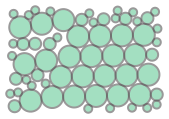

In [7]:
bps_top = gp.circle_pack_within_poly(drawbox, rads=[11, 6, 4])
bps_top

In [8]:
n_lower_layers = 4
for ii in range(n_lower_layers):
    bps = gp.circle_pack_within_poly(drawbox, rads=[9, 7, 3])
    bps_top = so.unary_union([bps.difference(bps_top), bps_top.buffer(-0.01)])

In [9]:
all_bps = bps_top

In [10]:
n_layers = 1

In [15]:
layers = []
for ii in range(n_layers):
    fills = []
    for p in all_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=np.random.uniform(0.01, 0.02), scale=np.random.uniform(0.01, 0.25)).rvs
        dist_from_center = p.centroid.distance(all_bps.centroid)
        a = np.interp(dist_from_center, [0, 170], [0, 1200])
        a = a // 45 * 45
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.2, 0.3),
            degrees=a,
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=8,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    layers.append(layer)

In [16]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

# sk.stroke(len(layers)+2)
# sk.geometry(blss)
    
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-21T18:00:05.085289 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="487.7957,43.9506 487.8176,44.0642 487.9586,44.7419 488.1063,45.4196 488.2578,46.0974 488.4102,46.7751 488.5613,47.4528 488.7089,48.1305 488.8509,48.8082 488.9856,49.486 489.1111,50.1637 489.226,50.8414 489.3289,51.5191 489.4184,52.1969 489.4936,52.8746 489.5536,53.5523 489.5979,54.23 489.6262,54.9077 489.6386,55.5855 489.6355,56.2632 489.6176,56.9409 489.5862,57.6186 489.543,58.2964 489.49,58.9741 489.4299,59.6518 489.3657,60.3295 489.3009,61.0073 489.2396,61.685 489.186,62.3627 489.1802,62.4585"/>
 <polyline points="489.8877,62.8307 489.9193,62.3627 489.9841,61.685 490.0628,61.0073 490.1503,60.3295 490.2418,59.6518 490.3329,58.9741 490.4198,58.2964 490.499,57.6186 490.5676,56.9409 490.6231,56.2632 490.6636,55.5855 490.6877,54.9077 490.6944,54.23 490.6832,53.5523 490.6539,52.8746 490.6068,52.1969 490.5425,51.5191 490.4618,50.8414 490.3659,50.1637 490.2562,49.486 490.1342,48.8082 490.0018,48.1305 489.8609,47.4528 489.7137,46.7751 489.5625,46.0974 489.4099,45.4196 489.2588,44.7419 489.1124,44.0642 488.9744,43.3865 488.9332,43.1639"/>
 <polyline points="489.6991,42.7328 489.8183,43.3865 489.9551,44.0642 490.101,44.7419 490.2519,45.4196 490.4046,46.0974 490.5561,46.7751 490.7037,47.4528 490.8449,48.1305 490.9776,48.8082 491.0996,49.486 491.2092,50.1637 491.3047,50.8414 491.3848,51.5191 491.4481,52.1969 491.494,52.8746 491.5217,53.5523 491.531,54.23 491.5223,54.9077 491.4959,55.5855 491.4532,56.2632 491.3956,56.9409 491.3254,57.6186 491.2451,58.2964 491.1582,58.9741 491.0684,59.6518 490.9801,60.3295 490.8983,61.0073 490.8283,61.685 490.7758,62.3627 490.747,63.0404 490.7473,63.2058"/>
 <polyline points="491.7347,63.535 491.7059,63.0404 491.6921,62.3627 491.6996,61.685 491.7241,61.0073 491.7612,60.3295 491.8071,59.6518 491.858,58.9741 491.9106,58.2964 491.9617,57.6186 492.0087,56.9409 492.0492,56.2632 492.0813,55.5855 492.1034,54.9077 492.1142,54.23 492.1127,53.5523 492.0982,52.8746 492.0705,52.1969 492.0293,51.5191 491.9748,50.8414 491.9072,50.1637 491.8271,49.486 491.7351,48.8082 491.6322,48.1305 491.5192,47.4528 491.3974,46.7751 491.2684,46.0974 491.1337,45.4196 490.9954,44.7419 490.8559,44.0642 490.7179,43.3865 490.5848,42.7087 490.5191,42.3502"/>
 <polyline points="491.4777,42.0072 491.4783,42.031 491.5158,42.7087 491.5695,43.3865 491.6363,44.0642 491.7135,44.7419 491.7985,45.4196 491.8892,46.0974 491.9835,46.7751 492.0793,47.4528 492.1749,48.1305 492.2684,48.8082 492.3581,49.486 492.4425,50.1637 492.52,50.8414 492.5892,51.5191 492.6491,52.1969 492.6985,52.8746 492.7368,53.5523 492.7636,54.23 492.7788,54.9077 492.7827,55.5855 492.776,56.2632 492.7599,56.9409 492.7362,57.6186 492.707,58.2964 492.675,58.9741 492.6436,59.6518 492.6164,60.3295 492.5977,61.0073 492.5924,61.685 492.6054,62.3627 492.6424,63.0404 492.7091,63.7181 492.7165,63.7669"/>
 <polyline points="493.3419,63.8597 493.3159,63.7181 493.2263,63.0404 493.1654,62.3627 493.1275,61.685 493.1073,61.0073 493.0998,60.3295 493.1005,59.6518 493.1056,58.9741 493.1114,58.2964 493.1151,57.6186 493.1143,56.9409 493.1072,56.2632 493.0923,55.5855 493.0689,54.9077 493.0364,54.23 492.9949,53.5523 492.9448,52.8746 492.8867,52.1969 492.8216,51.5191 492.7506,50.8414 492.6753,50.1637 492.5969,49.486 492.5172,48.8082 492.4376,48.1305 492.36,47.4528 492.2858,46.7751 492.2167,46.0974 492.1541,45.4196 492.0995,44.7419 492.0542,44.0642 492.0197,43.3865 491.9973,42.7087 491.9882,42.031 491.9896,41.8755"/>
 <polyline points="493.0627,41.6561 493.0525,42.031 493.0523,42.7087 493.0677,43.3865 493.0965,44.0642 493.1

In [17]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-21T18:00:45.195550 
 
 
 
 
 
 <polyline points="508.3706,40.2261 508.3908,46.4703 508.2427,46.6272 508.5576,51.4943 508.6217,56.6258 507.9773,70.7037 507.1534,70.0392 507.6574,55.7705 507.4178,47.249 507.5375,40.4158 506.5882,40.7091 506.5273,48.056 506.7338,56.6258 506.5045,69.451 505.7599,68.6521 505.6451,41.094 504.7882,41.5326 504.7742,47.5802 504.2556,46.7564 504.583,49.9309 504.7525,49.7659 504.7529,67.3818 504.9236,67.9291 499.5615,63.0819 498.774,63.2118 499.4565,57.6186 499.3296,52.8746 498.5804,46.7751 497.7325,41.9215 496.8737,41.7151 498.1331,50.1637 498.5479,54.23 498.5381,58.2964 497.9851,63.4895 498.7658,63.4154 502.2,66.5068 509.9795,72.6315 509.5346,73.5765 514.9907,78.3736 515.754,79.0731 515.8321,79.3246 516.7959,77.9799 516.9314,78.1118 517.3776,77.639 517.2433,77.5057 517.0419,77.6522 511.3484,72.9093 511.3859,72.6818 511.5786,72.8712 511.6867,72.7493 511.9388,69.4544 512.3871,60.902 512.4718,55.7705 512.2662,50.6391 511.7116,44.7695 512.0312,44.615 512.0297,44.4149 511.1073,44.9598 511.0456,40.0678 511.9876,40.1616 512.011,42.372 512.9089,40.329 512.9191,41.6548 513.8484,41.0629 513.8435,40.5798 515.2513,40.4221 510.8182,44.8457 511.4057,49.7838 511.6302,55.7705 511.41,62.6125 510.7499,72.3571 509.7801,71.9692 509.0253,71.4286 509.6086,56.6258 509.5342,51.4943 509.149,46.025 509.3623,45.8531 509.3134,40.0891 510.1763,40.0467 510.241,45.3696 509.8137,45.6266 510.495,52.3496 510.657,59.1915 510.3496,67.7439 510.017,72.0104 509.8888,72.0753 516.5513,78.1935 516.4029,78.4134 516.539,78.5447 515.6964,94.0279 515.3517,105.8632 515.2556,134.0765 515.3473,134.5153 515.6125,134.5265 515.5362,134.78 508.4669,135.4155 500.1046,136.8849 493.4148,138.6141 488.3975,140.2978 487.5036,140.6479 487.4252,140.9013 486.6942,140.8896 487.1563,141.0076 477.7342,151.1154 455.6004,172.7124 455.293,172.5841 455.3288,172.282 454.0035,170.9564 453.8071,171.2667 423.8294,170.8949 372.6539,170.8392 372.503,171.3136 372.3138,171.3013 372.3097,171.1247 371.0412,171.2181 371.1617,170.4852 372.4971,170.3763 372.8412,170.0916 423.8294,170.1331 453.6164,170.5 453.1938,168.813 428.5635,168.5447 376.4883,168.5165 373.2467,168.4724 373.2518,168.2969 373.0449,168.1895 370.7616,168.3483 370.6736,168.1525 370.4763,168.1422 370.4713,167.8114 370.5846,167.6414 373.2277,167.4594 373.3052,167.3059 373.4975,167.316 373.4398,167.7017 376.4883,167.7408 423.8294,167.7833 453.0066,168.0653"/>
 <polyline points="455.8703,171.3238 453.5024,168.956 453.4637,169.7346 453.4669,169.5919 428.5635,169.3552 383.5895,169.3931 373.0406,169.2952 372.8393,169.1656 370.9947,169.3592 370.9009,169.06 370.7036,169.0497 370.8919,168.8681 372.9102,168.7271 372.6151,169.9052 371.0901,170.0022 370.9673,170.205 370.6025,168.8016 370.5453,186.0162 370.8283,185.9749 371.4143,190.987 373.6269,204.8323 374.7764,213.7233 379.9422,218.1683 385.0646,223.0884 402.5457,241.8251 402.5972,241.1896 404.0319,241.703 404.6007,248.0559 404.9642,248.2921 405.3022,247.8162 409.2693,249.0489 411.6363,249.6079 414.0034,250.0473 418.7375,250.5992 425.8387,250.7543 432.9398,250.3418 442.408,249.3025 468.4456,245.7056 477.9138,244.5843 485.6942,244.0605 486.7484,245.245 488.6211,244.929 489.5972,245.2183 497.1029,242.7882 504.2041,240.8668 511.3052,239.6173 518.4064,239.1026 523.1405,239.1232 527.8746,239.3709 544.444,240.96 551.5452,241.4262 558.6463,241.4862 566.8925,240.9688 567.0132,241.2242 558.6463,241.6582 551.5452,241.6623 544.444,241.3418 527.8746,240.2027 520.7735,240.0784 516.0393,240.2786 508.9382,241.1143 501.837,242.6318 497.1029,243.9758 489.2171,246.5215 488.9479,247.5962 497.1029,244.8445 504.2041,242.7804 511.3052,241.3513 518.4064,240.6349 523.1405,240.5203 527.8746,240.6416 546.811,242.1643 553.9122,242.5694 561.0134,242.6379 567.509,242.3954 567.6701,241.8709 567.3362,233.2398 567.5372,241.7132"/>
 <polyline points="568.7017,245.0557 568.4312,244.8604 568.5071,244.5117 568.1678,244.2366 561.0134,244.59

In [18]:
def vsketch_to_shapely(sketch):
    return [[LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer] for layer in sketch.document.layers.values()]

In [19]:
layer = sk.document.layers[1]

In [20]:
mls = gp.make_like(MultiLineString([LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer]), drawbox)

In [21]:
P = gp.Poly(drawbox)

In [22]:
ds = [max(P.height, P.width) - ls.distance(drawbox.centroid) for ls in mls]

In [23]:
ds = np.array(ds) ** 0.5
ds = ds / ds.sum()

In [29]:
frac_keep = 0.55
n_keep = int(frac_keep * len(mls))
pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
                                             p=ds
                                            )))
rlayers = [pmls]

<ipython-input-29-8647ef1e120a>:3: FutureWarning: The input object of type 'LineString' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'LineString', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
<ipython-input-29-8647ef1e120a>:3: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,


In [30]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(rlayers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
    sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-21T18:01:12.091183 
 
 
 
 
 
 <polyline points="339.0839,64.2599 338.7935,63.5034 340.3558,61.676 342.2597,59.9486 345.8842,57.521 353.8696,53.4021 356.8872,51.578 360.2548,48.8935 361.4477,47.6654 362.9071,45.7894 366.3896,45.7087 369.3022,45.3188 369.4806,45.8173 366.3896,46.1734 363.5675,46.2741 360.9011,49.5397 357.6884,52.3792 354.7812,54.3136 347.09,58.7267 343.6515,61.3404 341.8652,63.1853 340.3141,65.2531 340.1398,65.1433 340.1742,65.4326 335.4977,69.8655 330.2323,75.3334 330.4303,75.8543 330.6201,75.9197 330.6691,76.3033 330.9913,76.3567 340.9767,66.211 342.096,64.6266 343.7954,62.6947 346.3962,60.4538 349.3207,58.5366 355.5522,55.0847 358.5047,53.1955 361.7703,50.4089 364.2239,47.3728 367.1211,47.2832 369.7947,46.9969 369.9595,48.0637 364.7126,48.4061 362.4637,51.1024 359.1771,53.8679 356.234,55.7665 349.2899,59.7163 345.7637,62.2421 343.9024,64.0121 342.7866,65.3172 341.8829,66.574 342.098,67.0633 336.2139,73.0142 331.9714,77.687 332.0327,78.2308 332.1069,78.1339 331.9992,78.2485 320.2005,66.2997 322.0059,63.6714 324.1495,60.9498 327.5768,57.0795 331.4036,53.3322 330.922,53.2423 333.0645,50.8659 333.8386,51.6145 332.4434,53.1675 332.8739,53.26 328.2258,57.7286 323.6514,62.8843 320.8957,66.4735 321.2332,66.9122 321.9119,67.3684 321.5577,67.247 321.52,66.9836 326.7251,61.0929 330.3519,57.4221 334.856,53.264 334.5011,52.3838 333.8426,53.1006 335.8929,52.8935 339.1573,50.7941 347.0839,46.6164 349.2945,45.1957 351.3534,43.6234 354.9397,40.1628"/>
 <polyline points="362.0172,44.277 365.658,44.2576 368.6636,43.896 368.9397,44.4634 364.9264,44.908 362.5932,44.9217 362.1028,44.7657 361.1259,46.1333 359.4164,48.0551 356.1627,50.8535 352.4909,53.2338 344.663,57.5102 341.784,59.4729 339.8534,61.1736 338.3369,62.8878 338.2807,63.2565 332.2301,69.0305 328.426,73.1622 328.7509,73.577 328.7948,73.907 329.7561,75.0722 329.4968,74.3436 331.0027,72.6682 335.8194,67.7547 339.2549,64.5049 339.5305,64.4148 341.1394,62.4596 342.9945,60.6834 346.5397,58.1764 354.4252,53.9577 357.395,52.0858 360.6686,49.3073 361.8156,48.0334 363.1793,46.1564"/>
 <polyline points="365.5628,52.2936 363.4445,54.504 360.7653,56.6665 351.8202,62.2465 348.3294,64.8079 345.2088,67.7393 344.7447,68.2396 344.7836,68.5509 338.233,75.0334 333.4702,80.1877 332.773,79.2452 332.9139,79.701 333.1971,79.7319 339.0348,73.4027 344.2105,68.2798 344.3762,68.3163 344.2067,67.9851 345.9194,66.0292 349.1115,63.1691 351.9724,61.1883 358.0487,57.5812 360.9585,55.6492 363.6114,53.4605 365.4414,51.5338 365.7511,51.7584 369.8512,51.1714 369.9606,50.4336 365.281,50.8933 363.1646,53.0137 360.4323,55.123 357.4449,56.9774 351.2135,60.4294 348.281,62.3386 345.0382,65.1479 343.1304,67.4026 338.0919,72.4598 332.5297,78.6185 332.3724,78.3561 335.5455,74.7784 342.6043,67.3959 342.5701,67.1109 342.7296,67.1624 344.6838,64.7936 347.2081,62.4762 350.0403,60.4666 356.9113,56.4437 359.8374,54.5282 362.5093,52.3583 364.9408,49.7327 370.0254,49.2772 369.9915,48.5388 364.9437,48.9549 365.3738,50.1743 369.9876,50.0461"/>
 <polyline points="375.0811,53.4106 365.1642,64.1424 365.2624,64.2679 365.1322,64.3547 379.6619,81.842 385.9631,88.9411 390.8423,94.1122 399.2222,102.4828 417.9942,120.6094 418.0699,120.5379 418.0346,120.7894 438.8866,141.5873 459.7288,161.4373 459.9324,161.1712 459.8857,161.6906 474.4286,147.6451 477.481,144.4689 477.1393,144.5887 477.1333,144.0702 477.673,143.8369 500.6739,123.32 500.2005,124.4094 500.4077,124.4136 500.5787,123.6097 507.9666,122.2567 507.8971,121.95 508.1003,121.9566 507.7929,121.7711 501.0903,123.0588 501.0628,122.5861 501.27,122.5904 501.1492,122.5804 501.4425,121.7833 501.65,121.787 501.6137,121.9522 507.7094,120.752 507.9848,92.3673 507.7787,92.2696 507.6412,92.5416 504.1516,89.5661 504.102,89.8049 503.8302,89.5467 503.7978,89.6567 501.8028,88.2533 501.842,88.867 502.1751,89.186 501.9331,89.1834 487.375,103.5706 467.8339,124.2306 461.2152,131.0123 448.4496,143.4646 447.906,143.5111 447.90

In [31]:
plot_id = fn.new_plot_id()

saved 20211221-180113_025531-b365a-5cac19 to s3://algorithmic-ink/current_plot_id


In [32]:
savedir='/home/naka/art/plotter_svgs'

In [33]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

# Try 4

In [26]:
image_path= '/home/naka/art/wigglesphere.jpg'

paper_size:str = '11x14 inches'
border:float=20  # mm

savedir='/home/naka/art/plotter_svgs'

In [3]:
# make page
paper = Paper(paper_size)
drawbox = paper.get_drawbox(border)


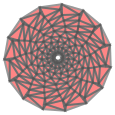

In [286]:
n_pts = 16
pts = []
radii = np.linspace(0.1, 1, 10)
for r in radii:
    thetas = np.linspace(0, 2*np.pi, n_pts) + np.random.rand()
    pts += [Point(np.cos(theta)*r, np.sin(theta)*r) for theta in thetas]
polys = so.triangulate(MultiPoint(pts))

all_bps = gp.make_like(MultiPolygon(polys), drawbox)

mask = all_bps.centroid.buffer(3.1)
all_bps = gp.merge_Polygons([p.difference(mask) for p in all_bps])
all_bps

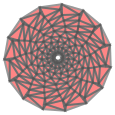

In [287]:
all_bps

In [288]:
n_layers = 1

In [289]:
all_bps.bounds

(35.507426433010686, 10.0, 142.2925735669893, 117.0)

In [328]:
layers = []
for ii in range(n_layers):
    fills = []
    for p in tqdm(all_bps):
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.01, 0.05)).rvs
        dist_from_center = p.centroid.distance(all_bps.centroid)
        a = np.interp(p.centroid.y, [0, 120], [0, 1200]) + np.random.randn()*15
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.45, 0.5),
            degrees=a,
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=8,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    layers.append(layer)

100%|██████████| 290/290 [00:03<00:00, 83.58it/s] 


In [329]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

# sk.stroke(len(layers)+2)
# sk.geometry(blss)
    
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-10T23:53:58.838545 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="478.2471,356.3142 476.5029,357.9359 474.5974,359.7146 472.6953,361.4968 470.7963,363.2823 468.9002,365.0709 467.0066,366.8621 465.1153,368.6556 463.2257,370.451 461.3374,372.2478 459.4501,374.0456 457.5634,375.844 455.6769,377.6426 453.7901,379.441 451.9029,381.2389 450.0148,383.0359 448.1258,384.8318 446.2355,386.6265 444.3438,388.4197 442.4507,390.2114 440.5561,392.0015 438.6599,393.7901 436.7624,395.577 434.8634,397.3626 432.9632,399.1469 431.062,400.93 429.1598,402.7122 427.4197,404.3412"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="497.2986,274.5841 497.5345,274.6944 498.6154,275.2023 499.6956,275.7117 500.7753,276.2224 501.8544,276.734 502.9334,277.2462 504.0121,277.7587 505.0909,278.2713 506.1697,278.7837 507.2486,279.2958 508.3278,279.8075 509.4071,280.3188 510.4866,280.8297 511.5663,281.3403 512.6461,281.8505 513.726,282.3606 514.8059,282.8707 515.8858,283.3809 516.9655,283.8914 518.045,284.4023 519.1243,284.9138 520.2032,285.4259 521.2818,285.9387 522.3601,286.4523 523.438,286.9666 524.5156,287.4815 525.5931,287.9968 526.5771,288.4676"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="364.5473,41.4422 363.7917,41.6681 361.2938,42.4129 358.7958,43.1569 356.2977,43.901 353.7997,44.6456 351.3021,45.3913 348.8049,46.1384 346.3083,46.8871 343.8121,47.6377 341.3165,48.39 338.8215,49.1442 336.327,49.9 333.8329,50.6573 331.3391,51.4157 328.8456,52.175 326.3523,52.9348 323.859,53.6948 321.3656,54.4544 318.872,55.2134 316.3781,55.9714 313.8838,56.7279 311.3889,57.4827 308.8935,58.2354 306.3973,58.986 303.9005,59.7342 301.4029,60.48 298.9047,61.2236 296.4058,61.9651 294.5656,62.5097"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 

In [330]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-10T23:54:01.952389 
 
 
 
 
 
 <polyline points="142.4122,278.9512 161.7234,293.8917 161.8905,294.2634 167.1041,293.2403 167.1501,292.9086 172.5026,290.1564 172.7956,289.6028 188.9021,299.9254 189.009,299.0414 191.7943,298.3557 191.6553,298.604 199.5402,302.273 204.018,304.3437 204.6996,304.3364 190.2836,311.2139 190.4964,311.9509 156.6735,313.6518 156.0504,313.8316 157.4519,309.3189 156.9142,309.735 146.4642,301.7022 146.8752,304.0097 155.6035,310.7495 155.0115,311.2076 154.0288,314.415 154.2246,311.8167 147.3192,306.5026 147.7707,309.0382 152.8082,312.9129 152.5179,313.1375 151.9293,315.021 151.3208,314.0641 148.2398,311.6716 148.6691,314.0823 149.982,315.1002 150.1399,314.9781 149.9471,315.593 148.9897,315.8719 191.0235,313.7765 190.7934,312.9796 208.985,304.2908 208.5268,304.2956 192.6069,296.9044 193.0263,296.1554 189.2453,297.0853 189.3482,296.2339 174.3719,286.6244 173.9628,287.3975 167.4504,290.7424 167.3628,291.3745 161.1362,292.586"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="179.0493,277.7865 190.6589,285.3874 200.3703,283.0392 200.727,282.4021 212.5853,287.9096 212.5026,288.6428 221.3687,303.3954 222.0124,303.3423 212.7898,310.9368 212.8751,311.2141 210.2243,311.83 210.2346,311.6793 192.8241,320.0123 192.605,319.2537 154.5716,320.8602 152.2132,320.6346 156.8953,322.9369 156.614,322.6855 193.1491,321.1379 193.3287,321.7598 210.0961,313.7161 213.4236,312.9959 213.3731,312.8318 225.3058,303.0707 213.1491,282.9152 213.2505,282.0174 203.5417,277.3751 204.0357,276.4928 191.359,279.5942 191.3361,279.7837 181.4317,273.285 181.0857,273.9388 168.9085,280.227 168.9557,279.887 156.5082,282.295"/>
 
 
 
 <polyline points="156.3188,326.6988 167.0237,331.9883 166.3072,331.3479 195.7071,329.9969 195.8526,330.5008 209.399,323.9685 209.4556,323.1355 216.0837,321.6376 216.3451,322.4867 232.3543,309.3591 232.4076,308.7777 235.5407,310.4987 239.1031,308.9636 239.7367,309.64 241.4539,300.1372 241.2457,300.1937 236.6342,297.4037 233.674,295.5623 233.6924,295.3774 230.6193,295.6023 231.2082,297.3004 233.5189,297.121 233.4989,297.322 239.035,300.7944 239.4656,300.6774 238.1634,307.9604 237.7573,307.5268 234.9813,308.7307 234.7279,307.93 232.5931,306.7573 215.76,320.5858 215.5292,319.8361 209.587,321.2028 209.5374,321.9331 195.3569,328.7843 195.2083,328.2695 164.5626,329.7889"/>
 
 
 <polyline points="166.4398,341.6483 192.7872,355.0122 193.158,355.3436 202.974,355.1643 203.0552,355.4454 207.4011,353.352 207.4171,353.1173 224.5739,349.2189 224.6219,349.3745 229.009,345.7985 228.9294,346.6655 241.4403,353.2594 242.3085,352.8617 238.8828,372.751 238.2828,372.0386 231.8506,397.2866 230.2639,396.7776 236.9424,370.4472 237.3311,370.9086 240.2297,353.8139 239.3468,354.2183 228.7464,348.6582 228.7687,348.4161 225.2193,351.3154 225.0968,350.9174 207.2896,354.993 207.2638,355.3719 203.5472,357.1494 203.509,357.0173 195.221,357.1872"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="352.506,427.4155 366.1846,433.9969 365.3679,434.4725 369.1914,437.2916 367.1252,437.8879 363.7652,435.4058 364.3581,435.0605 352.4423,429.3342 352.4508,429.0754 346.1522,419.0683 346.3961,418.4684 342.22,419.5676 341.6823,419.0129 338.7761,419.3307 340.9452,418.2526 347.1582,416.5938 346.9466,417.1141 352.5541,425.9662 352.5699,425.4891 368.0332,432.9203 368.7463,432.5051 373.5183,436.0428 375.4812,435.4763 370.293,431.6044 369.9959,431.7774 352.64,423.3784 352.6584,422.8245 347.7515,415.1342 347.9799,414.5722 339.5574,416.8209 340.0784,417.3584 335.6953,417.8351"/>
 <polyline points="332.6145,416.3395 338.4772,415.7067 338.1145,415.3326 348.817,412.5131 348.519,413.2459 352.7573,419.846 352.7703,419.4554 373.6426,429.6538 379.7168,434.2539 381.8485,433.6387 375.3417,428.6643 352.8321,417.5962 352.857,416.8458 349.2923,411.3437 349.6161,410.5471 336.7541,413.9292 336.834,414.0117 329.4731,414.8145 329.8135,414.9797 291.7152,402.4993 28

In [331]:
def vsketch_to_shapely(sketch):
    return [[LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer] for layer in sketch.document.layers.values()]

In [332]:
layer = sk.document.layers[1]

In [333]:
mls = gp.make_like(MultiLineString([LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer]), drawbox)

In [334]:
P = gp.Poly(drawbox)

In [335]:
ds = [max(P.height, P.width) - ls.distance(drawbox.centroid) for ls in mls]

In [336]:
ds = np.array(ds) ** 3
ds = ds / ds.sum()

<AxesSubplot:ylabel='Count'>

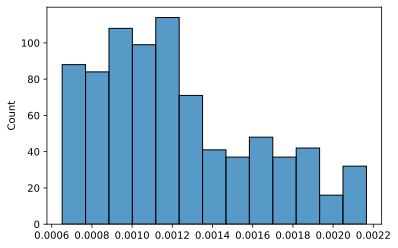

In [337]:
sns.histplot(ds)

In [342]:
frac_keep = 0.55
n_keep = int(frac_keep * len(mls))
pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
                                             p=ds
                                            )))
rlayers = [pmls]

<ipython-input-342-8647ef1e120a>:3: FutureWarning: The input object of type 'LineString' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'LineString', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
<ipython-input-342-8647ef1e120a>:3: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,


In [343]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(rlayers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
    sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-10-10T23:54:27.587840 
 
 
 
 
 
 <polyline points="457.4462,237.3769 461.7057,241.5614 461.9632,240.789 464.071,243.9139 463.6193,244.4289 465.3168,253.5557 465.1518,253.4554 453.7291,267.0514 453.8685,266.5917 445.7646,264.5607 445.2976,265.0852 424.5806,273.0661 424.4264,272.7187 408.7892,274.6124 409.1198,273.8631 400.0364,274.8014 399.8791,274.222 384.8232,276.5718 385.1158,276.06 380.2059,277.4084 377.0757,279.1896 376.3809,279.0922 380.0176,282.0865 379.2781,282.6286 381.9065,286.1712 381.8833,286.3211 397.0144,292.7001 396.6105,293.0662 391.9912,313.5962 392.2401,322.7934"/>
 
 
 <polyline points="457.4294,251.4611 458.3822,251.7095 460.4909,250.6232 457.7134,253.9145 457.8558,253.4448 456.0794,252.9772 455.7774,253.3164 434.3372,261.6072 434.4168,261.2775 421.6614,266.4894 421.3379,265.7606 412.195,266.8925 412.381,266.471 398.1365,267.8035 397.9323,267.0513 389.5044,268.3836 389.1547,268.9953 375.7574,273.0682 376.0403,273.3442 368.2619,277.9542 366.4603,277.7017 375.6429,285.2934 376.274,284.8308 381.1045,291.3454 381.0149,291.9236 392.3999,296.8834 392.1385,297.1205 388.3637,312.5677 388.7085,324.7051 386.9029,325.6824 386.5224,312.0457 389.5628,299.4555 389.349,299.6493 380.4272,295.7158 380.318,296.42 373.3089,287.0044 372.8398,287.3483 362.5943,278.9507 359.686,276.7522 365.5251,273.0355 371.8805,269.2857"/>
 
 
 
 
 
 <polyline points="338.2689,283.0711 328.8201,278.258 330.8945,278.642 339.3573,277.1027 339.6051,276.3522 353.83,274.0482 353.557,273.505 354.5407,273.0069 354.5097,272.6976 366.6228,264.4146 367.0971,264.803 367.5238,264.4532 367.1957,263.8784 372.8097,249.9212 373.2792,250.0498 373.8786,249.0786 374.0054,249.1717 374.8197,242.2688 375.3674,234.3675 374.5354,234.4946 374.7,233.3694 375.1139,233.4595 367.2286,221.1337 367.8572,220.7304 365.6444,219.3844 356.5858,211.5326 356.8355,211.1528 355.2684,209.4508 355.0004,209.6436 344.1885,202.573 344.3133,201.8119 343.8134,200.8722 343.3364,201.6893 333.1072,199.6207 333.5449,199.6092 337.2513,192.1035 336.6926,191.5644 346.6172,179.5756 346.3519,179.5768 348.0537,170.9771"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="355.6545,105.3217 345.883,119.3551 347.5473,119.6747 356.9065,106.2462 356.6892,106.0857 354.1456,79.841 353.9164,80.2479 347.4117,75.5445 346.9538,75.4312 356.6575,72.6376 356.5064,73.248 358.4713,73.0675 358.3669,73.2216 361.8864,82.3658 361.8021,82.3025 360.3795,85.8226 360.1749,85.4789 362.6018,110.4514 362.5088,110.3827 355.0568,121.1171 357.0203,121.4942 363.9895,111.476 364.5549,111.8935 362.3807,89.1859 362.8111,89.909 364.9348,84.6538 364.6655,84.4517 359.6476,71.3315 359.8086,71.0939 356.9768,71.3479 357.126,70.7449 343.7347,74.6349 342.4593,74.3194 352.9988,81.8771"/>
 
 
 
 
 
 
 
 
 
 <polyline points="392.769,216.7977 407.8866,227.1758 408.5506,226.8045 408.5481,245.6238 408.768,245.8935 406.6681,256.9372 408.5153,256.7687 410.1849,247.6315 410.3254,247.8038 410.3002,225.8262 409.7375,226.1408 397.5064,217.6553 391.8601,214.0403 391.0603,211.614 398.4722,216.1383 411.5611,225.1211 412.1024,224.8184 412.0391,249.9058 411.6226,249.395 410.2866,256.6071 412.1029,256.4414 413.0763,251.178 413.7717,252.031 413.8215,223.8571 413.4651,224.0565 396.1515,212.5103 390.2532,209.1656 390.3593,209.4874 390.047,208.6163 390.393,208.1428 407.9673,202.288"/>
 
 
 
 
 
 
 <polyline points="413.9782,215.6663 408.0117,217.6567 405.7323,216.5048 413.2259,213.9919 413.2947,214.1451 420.1019,217.3467 419.9013,217.646 436.667,229.243 436.7656,229.7786 442.4085,231.5646 442.2119,232.1811 449.4088,246.0715 433.9776,251.8251 418.0325,258.3139 418.345,259.0178 415.5062,259.3868 415.5701,259.2422 410.8325,259.5985 396.2761,260.9512 396.4747,261.6828 393.0223,262.23 393.2438,261.8426 371.227,268.6481 370.5096,267.9481 363.795,271.8895 356.9308,276.366 356.1987,276.2634 361.4894,280.3583 371.3925,288.4092 371.8534,288.0714 379.9272,298.9414 379.8567,299.3

In [344]:
plot_id = fn.new_plot_id()

saved 20211010-235441_779304-b365a-738707 to s3://algorithmic-ink/current_plot_id


In [345]:
savedir='/home/naka/art/plotter_svgs'

In [346]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

## postcards

In [26]:
image_path= '/home/naka/art/wigglesphere.jpg'

paper_size:str = '7x5 inches'
border:float=10  # mm
image_rescale_factor:float=0.04
smooth_disk_size:int=1
hist_clip_limit=0.1
hist_nbins=32
intensity_min=0.
intensity_max=1.
hatch_spacing_min=0.35  # mm
hatch_spacing_max=1.1 # mm
pixel_width=1 # mm
pixel_height=1 # mm
angle_jitter='ss.norm(loc=10, scale=0).rvs'  # degrees
pixel_rotation='0'  # degrees
merge_tolerances=[0.3, 0.4,]  # mm
simplify_tolerances=[0.2,]  # mm
savedir='/home/naka/art/plotter_svgs'

In [27]:
# make page
paper = Paper(paper_size)
drawbox = paper.get_drawbox(border)


In [28]:
bps_top = gp.circle_pack_within_poly(drawbox, rads=[28, 6, 4])
bps_top = so.unary_union([gp.RegPolygon(point=c.centroid, radius=Shape(c).width/2, n_corners=3).poly for c in bps_top])

 67%|██████▋   | 2/3 [00:01<00:00,  1.99it/s]

In [29]:
n_lower_layers = 4
for ii in range(n_lower_layers):
    bps = gp.circle_pack_within_poly(drawbox, rads=[19, 7, 3])
    bps = so.unary_union([gp.RegPolygon(point=c.centroid, radius=Shape(c).width/2, n_corners=3).poly for c in bps])
    bps_top = so.unary_union([bps.difference(bps_top), bps_top.buffer(-0.01)])

In [30]:
all_bps = bps_top

In [31]:
bg = drawbox.buffer(-10).difference(all_bps).buffer(-0.01)

In [32]:
all_bps = so.unary_union([all_bps, bg])

In [33]:
n_layers = 1

In [88]:
layers = []
for ii in range(n_layers):
    fills = []
    for p in all_bps:
        xjitter_func = 0
        yjitter_func = ss.norm(loc=0, scale=np.random.uniform(0.01, 0.02)).rvs
        dist_from_center = p.centroid.distance(all_bps.centroid)
        a = np.interp(dist_from_center, [0, 170], [0, 1200])
        a = a // 45 * 45
        bhf = gp.BezierHatchFill(
            spacing=np.random.uniform(0.15, 0.25),
            degrees=a,
            poly_to_fill=p, 
            xjitter_func=xjitter_func, 
            yjitter_func=yjitter_func,
            fill_inscribe_buffer=1.4,
            n_nodes_per_line=8,
            n_eval_points=50,
        )
        fills.append(bhf.p)

    fills = [f for f in fills if f.length > 0]
    layer = gp.merge_LineStrings(fills)
    layers.append(layer)

In [89]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.3mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

# sk.stroke(len(layers)+2)
# sk.geometry(blss)
    
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-18T16:37:42.087588 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="153.7671,72.7351 153.7693,72.4564 153.7733,71.8237 153.7766,71.191 153.7791,70.5583 153.7807,69.9256 153.7815,69.2929 153.7813,68.6602 153.7803,68.0275 153.7784,67.3948 153.7757,66.7621 153.7722,66.1294 153.7679,65.4967 153.7631,64.864 153.7579,64.2313 153.7524,63.5986 153.7468,62.9659 153.7414,62.3331 153.7363,61.7004 153.7318,61.0677 153.7282,60.435 153.7256,59.8023 153.7243,59.1696 153.7245,58.5369 153.7263,57.9042 153.73,57.2715 153.7354,56.6388 153.7428,56.0061 153.752,55.3734 153.7567,55.1023"/>
 <polyline points="154.5069,55.5351 154.4991,56.0061 154.4896,56.6388 154.4813,57.2715 154.4743,57.9042 154.4686,58.5369 154.4644,59.1696 154.4615,59.8023 154.46,60.435 154.4597,61.0677 154.4606,61.7004 154.4625,62.3331 154.4652,62.9659 154.4687,63.5986 154.4727,64.2313 154.4771,64.864 154.4819,65.4967 154.4869,66.1294 154.4919,66.7621 154.497,67.3948 154.502,68.0275 154.5069,68.6602 154.5118,69.2929 154.5165,69.9256 154.5212,70.5583 154.5258,71.191 154.5304,71.8237 154.535,72.4564 154.5396,73.0891 154.5403,73.1811"/>
 <polyline points="155.3745,73.1823 155.3738,73.0891 155.3691,72.4564 155.3641,71.8237 155.3588,71.191 155.3534,70.5583 155.3478,69.9256 155.3421,69.2929 155.3362,68.6602 155.33,68.0275 155.3237,67.3948 155.317,66.7621 155.3101,66.1294 155.303,65.4967 155.2957,64.864 155.2883,64.2313 155.2809,63.5986 155.2736,62.9659 155.2666,62.3331 155.2601,61.7004 155.2541,61.0677 155.249,60.435 155.2449,59.8023 155.2419,59.1696 155.2403,58.5369 155.2403,57.9042 155.2419,57.2715 155.2452,56.6388 155.2504,56.0061 155.2509,55.9644"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polyline points="275.015,90.7828 275.0209,90.2472 275.0

In [90]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(layers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-18T16:37:56.598584 
 
 
 
 
 
 <polyline points="275.185,73.5435 288.7646,59.5699 288.7254,59.3291 297.9391,50.1584 298.9824,50.7604 289.7331,59.9105 275.185,74.8817 275.185,76.2243 290.4885,60.5645 290.3594,60.4463 290.7993,60.5256 300.0633,51.384 301.0806,51.9709 291.8828,61.1507 291.3275,61.0485 275.185,77.5623 275.185,78.8331 292.1483,61.5221 291.3474,60.8419 300.552,51.6659 304.0222,51.7924 305.0501,52.3854 301.6158,52.2797 292.3972,61.4475 292.4088,61.6287 292.8219,61.6268 292.9894,62.0074 275.185,80.1888 275.1472,79.434 275.015,90.7828 275.1011,103.8947 275.2672,103.8425 275.1777,116.1083 274.7596,115.9107 307.0851,148.2494 307.4096,211.3801 307.6687,211.2742 329.1031,232.2742 329.135,246.4794 328.8684,246.3691 323.1092,246.4067 311.6502,246.6223 313.0625,245.7639 312.9763,245.9009 327.7729,245.7371 327.6385,245.616 327.6178,237.3662 327.2212,236.4586 324.6734,239.065 324.7028,243.9659 315.7743,244.1556 324.7584,235.0377 324.6639,234.8354 324.8379,234.6913 303.5562,213.647 303.3283,213.7348 302.9673,145.8737 302.2087,145.436 302.5315,214.1945 302.7176,214.1308 322.5343,233.7109 322.2232,233.575 306.3287,249.7362 334.3055,249.5061 334.2349,229.3134 333.9497,229.4343 312.62,208.4177 312.4478,208.4733 312.0825,151.1327 312.4948,151.3269 280.249,119.0778 280.4348,119.1413 278.9156,117.5986 279.0606,117.4713 277.147,115.6547 277.147,114.8189 279.6677,117.1646 286.376,124.07 315.4486,153.0311 315.8334,206.5201 331.0388,221.5062 331.0766,221.8154 332.9805,223.7327 333.2102,223.6437 337.188,227.566 337.1571,251.1077 335.7148,250.2755 335.6612,228.4905 331.6081,224.5681 331.3982,224.6455 331.0766,224.3217 331.0388,224.0072 314.2735,207.4637 314.0968,207.522 313.7249,152.0802 314.521,152.5395 314.9539,207.0275 315.0799,206.9984 331.0388,222.7308 331.0766,223.042 332.2065,224.1792 332.4261,224.0961 336.4049,228.0178 336.4646,250.7518 317.063,250.8151 304.0846,251.0309 321.6114,233.2221 320.9659,232.8497 301.5662,252.4403 315.5515,252.0493 338.6354,251.9606 338.5774,226.808 338.8801,226.5897 334.9074,222.6646 335.2852,222.4029 331.0766,218.0953 331.0388,217.5614 318.2867,205.1046 317.8823,154.4788 318.2824,154.666 317.9659,154.3525 348.2202,153.8611 497.126,154.1191 497.4336,154.2529 497.5276,154.1588 497.8328,154.6577 497.9715,154.5196 501.4712,154.7022 501.7849,154.3903 502.1619,154.3474 500.4894,156.0159 500.1638,156.0026 500.9629,156.4637 501.0461,156.3807 501.7698,156.9292 502.066,156.9255 508.0424,150.9547 507.8242,150.906 507.5101,151.2181 497.6788,151.1482 497.5276,151.676 495.8587,153.3443 495.5865,153.2308 462.7477,153.2894 348.2202,153.0328 346.7133,153.0358 346.6755,153.4641 346.5243,153.2552 317.0056,153.69 316.9678,153.3638 287.2291,123.6215 287.09,123.6581 285.607,122.1691 285.9346,122.3144 280.4169,116.7324 280.6914,116.5304 277.147,113.1902 277.147,114.023 280.1428,116.8469 278.5084,117.7899 277.147,116.4994 276.697,116.9848 276.9814,89.7169 276.6065,89.6714 276.6039,89.8911 277.3897,89.4377 277.3918,89.2183 279.0159,88.2813 279.0145,88.5003 278.2161,88.7428 278.2141,88.9621 277.9217,89.1744 277.9019,102.2788 277.6532,102.4659 287.7323,112.4682 288.0271,112.3417 316.9678,141.4951 317.0056,141.2307 346.5243,140.9647 346.6755,140.6391 346.5621,140.5263"/>
 <polyline points="346.5243,145.7671 317.0056,146.1167 316.9678,146.2316 285.0413,114.0207 277.147,106.2576 277.147,107.1702 284.4887,114.3396 284.2378,114.528 317.0056,147.479 346.5243,147.1179 485.3848,147.4759 508.8909,123.9822 515.9254,130.8633 515.7156,131.1589 515.2231,131.2685 509.0798,125.1463 508.8909,125.1995 486.3491,147.8577 486.1442,147.9141 484.6225,147.0361 508.8909,122.7194 516.634,130.4545 517.3655,130.207 517.3478,130.0426 509.0798,121.7838 508.9287,121.9271 508.8909,121.4712 483.833,146.5806 348.2202,146.2893 346.7133,146.292 346.6755,146.502 346.5621,146.389 317.0056,146.7983 317.0056,145.436 346.5243,145.0945 346.7133,145.464 482.245,145.708 508.8909,119.0201 509.042,119.

In [91]:
def vsketch_to_shapely(sketch):
    return [[LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer] for layer in sketch.document.layers.values()]

In [92]:
layer = sk.document.layers[1]

In [93]:
mls = gp.make_like(MultiLineString([LineString([Point(pt.real, pt.imag) for pt in lc]) for lc in layer]), drawbox)

In [94]:
P = gp.Poly(drawbox)

In [95]:
ds = [max(P.height, P.width) - ls.distance(drawbox.centroid) for ls in mls]

In [96]:
ds = np.array(ds) ** 0.5
ds = ds / ds.sum()

In [98]:
frac_keep = 0.55
n_keep = int(frac_keep * len(mls))
pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
                                             p=ds
                                            )))
rlayers = [pmls]

<ipython-input-98-8647ef1e120a>:3: FutureWarning: The input object of type 'LineString' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'LineString', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,
<ipython-input-98-8647ef1e120a>:3: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pmls = MultiLineString(list(np.random.choice(mls, size=n_keep, replace=False,


In [99]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.08mm')
for i, layer in enumerate(rlayers):
    sk.stroke(i+1)
    sk.geometry(layer)

for tolerance in [0.05, 0.1, 0.2,  0.3, 0.5, 0.7]:
    sk.vpype(f'linemerge --tolerance {tolerance}mm')
    sk.vpype('linesimplify --tolerance 0.1 linesort')

sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-12-18T16:38:03.396780 
 
 
 
 
 
 
 
 
 <polyline points="68.0193,357.2017 78.3716,357.0838 78.1704,357.288 79.9545,356.2146 80.0257,357.3897 70.5762,366.9038 71.3499,367.4383 71.2682,367.3031 80.7731,357.8209 80.6147,357.6855 80.5517,355.826 55.197,356.0466 55.5308,355.5456 69.9381,340.8908 77.2941,333.6477 77.4802,333.711 77.4759,332.7573 78.0794,332.4091 78.087,334.0611 77.8833,333.9876 73.1503,338.6269 57.8145,354.228 83.6035,354.0653 83.6385,359.43 83.5043,359.3967 73.9639,368.8583 74.6629,369.2616 84.3209,359.8237 84.2799,353.7191 83.0545,354.4261 83.0762,359.1056 82.8427,359.0149 73.2871,368.4679 73.3493,368.6359 63.5034,368.5836 63.3889,368.427 63.0789,368.4282 63.0789,369.2769 63.3889,369.2776 63.5034,369.5521 75.0259,369.5151 75.2985,369.6283 84.9729,360.1999 84.9294,353.3444 76.3236,353.5588 62.2819,353.6271 61.4986,352.3229 86.7375,352.2133 86.635,344.259 87.0884,344.851 87.3492,344.596 87.3492,345.6064 87.0884,345.8623 87.3492,346.6751 87.0884,346.9325 87.3492,347.7331 87.0884,347.9911 87.3492,348.7477 87.0884,349.0045 87.3492,349.7564 87.0884,350.0126 87.3492,350.7905 87.0884,351.0462 87.3492,351.8271 87.0884,352.0842 86.0799,351.7899 86.2128,331.7256 86.5957,320.1343 86.4827,320.1554 86.3072,293.2613 86.2882,283.0342 86.4675,283.0495 86.3987,267.8515 85.9812,267.9601 85.9498,251.1903 86.2227,251.0834 86.2219,251.3033 86.48,251.364 86.5752,251.2427 81.9162,246.7693 81.9162,247.622 84.5141,250.362 84.5301,268.7973 84.2122,269.113 84.1999,273.0955 84.2569,286.4096 84.3764,286.6107 84.4077,319.2266 84.2299,319.8977 84.1724,323.0847 84.0558,323.196 84.1815,337.5773 84.361,337.7249 81.1647,340.7562 81.1874,344.2134 80.569,344.8698 80.5815,348.6176 67.8705,348.6466"/>
 
 
 
 <polyline points="73.3556,280.6794 73.2411,280.7938 73.3556,281.7709 71.9468,283.5495 71.807,276.3582 71.4718,276.3313 71.4283,273.1367 71.3192,258.9389 71.4126,242.8032 72.0254,242.9364 72.3784,242.5751 72.7185,242.7272 72.5576,234.2557 72.2511,234.3885 72.3428,223.6526 72.0262,223.7912 71.9795,223.5538 79.5163,215.8299 79.7589,215.9258 79.7541,215.7027 79.9414,215.7667 79.9506,205.3405 80.3414,205.3457 80.3878,194.3106 81.878,192.8646 87.2728,198.1947 87.053,198.2001 86.815,209.3009 86.8283,216.5149 86.5817,226.1205 86.4548,226.3259 115.191,255.1096 126.9389,254.8242 120.7186,248.6314 120.9237,248.3809 116.3895,248.4292 116.2819,248.6316 115.5643,248.0413 115.3055,248.3477 102.5657,235.4364 90.765,223.7951 91.0716,223.53 91.2993,213.9795 90.9621,214.1299 90.9552,211.6896 90.0632,210.9546 90.263,200.0521 90.929,200.4364 90.7032,211.3238 90.2639,211.2907 90.2718,214.5282 90.6257,214.5444 90.3232,224.094 115.2673,249.0417 115.3818,248.812 116.599,248.6823 116.9348,248.7879 117.1077,249.108 118.2406,249.5413 118.8749,250.0395 118.7534,250.0575 118.9557,249.5604 119.1853,249.516 120.8244,251.1642 120.9007,251.3404 115.3818,251.4913 115.0323,251.178 115.3437,252.1539 115.2292,252.268 115.2292,254.8734 115.3818,254.1519 125.3565,253.9112 124.3962,253.3131 120.2295,248.8695"/>
 
 <polyline points="86.001,226.4996 84.8293,227.2637 98.0113,240.4675 97.6769,240.3626 98.8939,241.1088 100.9095,243.1289 101.2107,243.2477 101.2135,242.9976 101.3579,243.0024 102.0473,243.7303 101.5954,242.7332 99.961,241.5923 85.2286,226.9012 85.4001,208.4846 85.6762,208.4676 85.5557,208.354 85.6995,197.4192 86.6927,197.9041 86.3675,197.8046 86.2274,208.7416 86.1087,208.8934 86.1791,217.0658 86.0613,217.1778 85.9092,226.6407 103.9433,244.7361 104.0772,244.9015 103.2553,244.4714 115.191,256.3994 115.3818,255.9643 128.5319,255.7432 121.2479,248.326 121.7999,248.0076 130.406,256.6923 130.0153,256.511 130.0517,256.6201 115.3818,256.866 115.2292,257.4192 115.2292,259.9255 115.3818,259.5159 134.5394,259.2092 122.9363,247.3519 122.537,247.4942 123.6818,246.8337 123.4562,247.0519 136.4047,260.1973 126.0301,260.2076 115.191,260.4415 99.1023,244.3919 98.8188,244.3351 91.0198,236.5659 91.9819,236.9888 83.1862,228.2117 

In [100]:
plot_id = fn.new_plot_id()

saved 20211218-163804_364561-b365a-1fa213 to s3://algorithmic-ink/current_plot_id


In [86]:
savedir='/home/naka/art/plotter_svgs'

In [87]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)